# Cluster ChromAtlas single cell ATAC-seq data


Julia notebook for clustering single-cell chromatin accessibility atlas on `slade.ex.ac.uk`. Data taken on chromatin accessibility of 222 cell types/tissues.

Zhang, K., Hocker, J. D., Miller, M., Hou, X., Chiou, J., Poirion, O. B., Qiu, Y., Li, Y. E., Gaulton, K. J., Wang, A., Preissl, S., & Ren, B. (2021). A single-cell atlas of chromatin accessibility in the human genome. *Cell*, 184(24), 5985–6001.e19. https://doi.org/10.1016/j.cell.2021.10.024

Data downloaded from: http://catlas.org/catlas_downloads/humantissues/

This repoistory makes use of *hg38* bigwigs made available with the paper. There are some issues with normalisation of these files as is seen below. In future we will reprocess all files. Its not obvious from the paper or methods exactly how the bigwigs are normalised, however, they appear to be normalised for sequencing depth.

In [1]:
include(joinpath("..", "src", "project.jl"));

In [2]:
meta, bwdict = loadchromatlasmeta();
meta

Progress: 100%|█████████████████████████████████████████| Time: 0:00:04


Row,Study,Cell,TotalPeaks,BedFile,BigWigFile
,String,String,Int64,String,String
1,ChromAtlas,A_Cardiomyocyte,111772,/slade/projects/Research_Project-MRC158833/tfs_chromatin/chromatlas/peaks/A_Cardiomyocyte.bed,/slade/projects/Research_Project-MRC158833/tfs_chromatin/chromatlas/bigwig/A_Cardiomyocyte.bw
2,ChromAtlas,Acinar,87216,/slade/projects/Research_Project-MRC158833/tfs_chromatin/chromatlas/peaks/Acinar.bed,/slade/projects/Research_Project-MRC158833/tfs_chromatin/chromatlas/bigwig/Acinar.bw
3,ChromAtlas,Adipocyte,100924,/slade/projects/Research_Project-MRC158833/tfs_chromatin/chromatlas/peaks/Adipocyte.bed,/slade/projects/Research_Project-MRC158833/tfs_chromatin/chromatlas/bigwig/Adipocyte.bw
4,ChromAtlas,Airway_Goblet,84546,/slade/projects/Research_Project-MRC158833/tfs_chromatin/chromatlas/peaks/Airway_Goblet.bed,/slade/projects/Research_Project-MRC158833/tfs_chromatin/chromatlas/bigwig/Airway_Goblet.bw
5,ChromAtlas,Alpha_1,120362,/slade/projects/Research_Project-MRC158833/tfs_chromatin/chromatlas/peaks/Alpha_1.bed,/slade/projects/Research_Project-MRC158833/tfs_chromatin/chromatlas/bigwig/Alpha_1.bw
6,ChromAtlas,Alpha_2,88737,/slade/projects/Research_Project-MRC158833/tfs_chromatin/chromatlas/peaks/Alpha_2.bed,/slade/projects/Research_Project-MRC158833/tfs_chromatin/chromatlas/bigwig/Alpha_2.bw
7,ChromAtlas,Alveolar_Cap_Endo,53976,/slade/projects/Research_Project-MRC158833/tfs_chromatin/chromatlas/peaks/Alveolar_Cap_Endo.bed,/slade/projects/Research_Project-MRC158833/tfs_chromatin/chromatlas/bigwig/Alveolar_Cap_Endo.bw
8,ChromAtlas,Alveolar_Type_1,101048,/slade/projects/Research_Project-MRC158833/tfs_chromatin/chromatlas/peaks/Alveolar_Type_1.bed,/slade/projects/Research_Project-MRC158833/tfs_chromatin/chromatlas/bigwig/Alveolar_Type_1.bw
9,ChromAtlas,Alveolar_Type_2,106723,/slade/projects/Research_Project-MRC158833/tfs_chromatin/chromatlas/peaks/Alveolar_Type_2.bed,/slade/projects/Research_Project-MRC158833/tfs_chromatin/chromatlas/bigwig/Alveolar_Type_2.bw


### Helper functions for finding where cells are in the table

In [3]:
cellind("Beta_1", meta.Cell) ## get the index of cell type Beta_1

14

In [4]:
bwfile("Beta_1", meta) ## get the bigwig file of cell type Beta_1

"/slade/projects/Research_Project-MRC158833/tfs_chromatin/chromatlas/bigwig/Beta_1.bw"

### Load dictionary of regions of interest (ROIs)

*Remember hg38 coords*

In [5]:
regions = loadrois() # loads hk1 coords
 ### here is how to add a new region
regions["scrt1_variant"] = ("chr8", 144337510:144337510)
regions["scrt1_roi"] = ("chr8", (144337510 - 2000):(144337510 + 2000))
regions["scrt1_peak"] = ("chr8", (144337510 - 100):(144337510 + 100))
regions

Dict{String, Tuple{String, UnitRange{Int64}}} with 6 entries:
  "scrt1_peak"    => ("chr8", 144337410:144337610)
  "hk1_variants"  => ("chr10", 69348854:69348961)
  "scrt1_variant" => ("chr8", 144337510:144337510)
  "hk1_roi"       => ("chr10", 69347894:69350486)
  "scrt1_roi"     => ("chr8", 144335510:144339510)
  "hk1_genelocus" => ("chr10", 69267991:69403882)

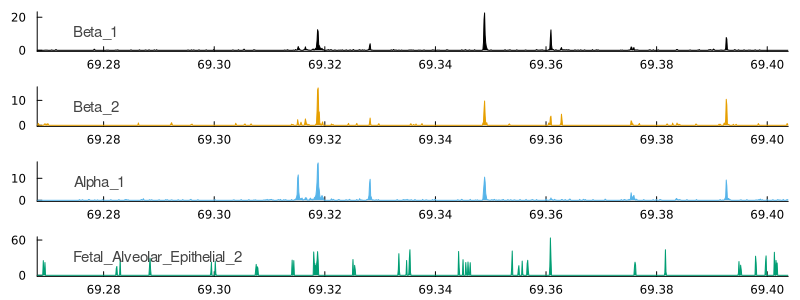

In [6]:

pbeta1  = plotregion(regions["hk1_genelocus"]..., "Beta_1",  meta, dx=100, c=1, norm=false)
pbeta2  = plotregion(regions["hk1_genelocus"]..., "Beta_2",  meta, dx=100, c=2, norm=false)

palpha1 = plotregion(regions["hk1_genelocus"]..., "Alpha_1", meta, dx=100, c=3, norm=false)
pother = plotregion(regions["hk1_genelocus"]..., "Fetal_Alveolar_Epithelial_2", meta, dx=100, c=4, norm=false)

plot(pbeta1, pbeta2, palpha1, pother, layout=(4, 1), size=(800, 300))

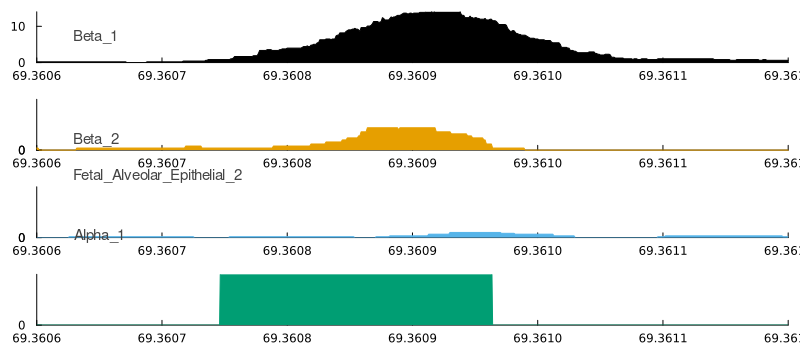

In [7]:
### specific coords yourself
pbeta1  = plotregion("chr10", 69360600:69361200, "Beta_1",  meta, dx=1, c=1, norm=false)
pbeta2  = plotregion("chr10", 69360600:69361200, "Beta_2",  meta, dx=1, c=2, norm=false)
palpha1 = plotregion("chr10", 69360600:69361200, "Alpha_1", meta, dx=1, c=3, norm=false)
pother = plotregion("chr10", 69360600:69361200, "Fetal_Alveolar_Epithelial_2", meta, dx=1, c=4, norm=false)

plot(pbeta1, pbeta2, palpha1, pother, layout=(4, 1), size=(800, 350), ylims=(0, 14))

## Cluster Chromatin accessibilty over HK1

Cluster data over HK1 region, normalisation of the data has a big impact on the results. Two possibilities:

  1. Cluster data normalised by max within +/- 50kb of `hk_roi`, this effectively scales the data by the largest peak within 50kb. A good strategy for HK1 scaling data by the peak at the promoter to assess the size of the peak at the regulatory silencer, this normalisation produces similiar results:
  `clusterall(regions["hk1_roi"]..., meta, k=5,  ex=50_000, maxnorm=true)`
  2. Cluster data in original units - applying square root transform prior to clustering
  `clusterall(regions["hk1_roi"]..., meta, k=8,  ex=0, maxnorm=false, normfun=x -> sqrt.(x))`
  
  
 In option 2 the cluster number is increased to aid clustering out of endocrine cell types. Option 1 does a better job at identifying endocrine specific activity, however, option 2 is a more generally applicable to multiple regions.
 
 #### Max norm clustering of HK1

In [8]:
ca_cluster_HK1_max = clusterall(regions["hk1_roi"]..., meta, k=5,  ex=50_000, maxnorm=true); ### note the time taken here is all spent loading data out of bigwig files

Progress: 100%|█████████████████████████████████████████| Time: 0:00:01


  0.623919 seconds (838.99 k allocations: 55.538 MiB, 3.96% gc time, 98.62% compilation time)


### Visulise Clusters
A few useful plotting functions and cluster summary functions:

  - `plot_cluster_centres_group` plot the cluster means overlayed and sizes
  - `plot_cluster_centres_grid` plot the cluster means in a grid
  - `cluster_heatmap` plot a heatmap of the clusters
  - `clustertable` A DataFrame with identities of clusters
  - `clustersummary` A DataFrame summarising clusters

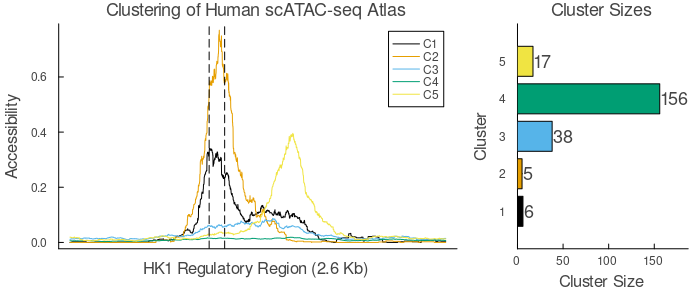

In [9]:
plot_cluster_centres_group(ca_cluster_HK1_max, xlabel="HK1 Regulatory Region (2.6 Kb)", markregion=regions["hk1_variants"])

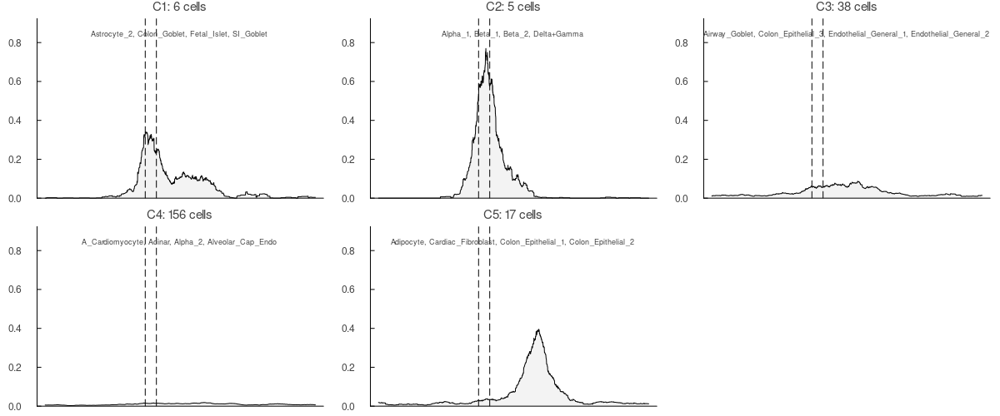

In [10]:
plot_cluster_centres_grid(ca_cluster_HK1_max, meta, markregion=regions["hk1_variants"])

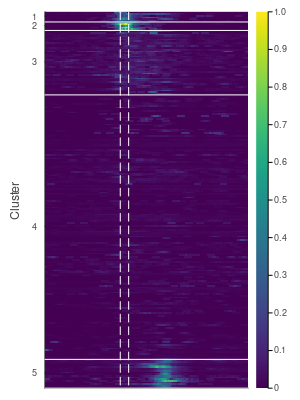

In [11]:
cluster_heatmap(ca_cluster_HK1_max, markregion=regions["hk1_variants"], size=(300, 400), xticks=false)

In [12]:
clustertable(ca_cluster_HK1_max, meta)

Row,Cell,Cluster
,String,Int64
1,A_Cardiomyocyte,4
2,Acinar,4
3,Adipocyte,5
4,Airway_Goblet,3
5,Alpha_1,2
6,Alpha_2,4
7,Alveolar_Cap_Endo,4
8,Alveolar_Type_1,4
9,Alveolar_Type_2,4


In [13]:
clustersummary(ca_cluster_HK1_max, meta)

Row,Cluster,count,Cell
,Int64,Int64,String
1,1,6,"Astrocyte_2, Colon_Goblet, Fetal_Islet, SI_Goblet, Skin_Eccrine_Epidermal, Skin_Granular_Epidermal"
2,2,5,"Alpha_1, Beta_1, Beta_2, Delta+Gamma, Paneth"
3,3,38,"Airway_Goblet, Colon_Epithelial_3, Endothelial_General_1, Endothelial_General_2, Fetal_Acinar_2, Fetal_Alveolar_Cap_Endo, Fetal_B_Lymphocyte_2_CXCR5+, Fetal_Endocardial, Fetal_Endothelial_General_1, Fetal_Endothelial_Placental, Fetal_Enteric_Neuron, Fetal_Fibro_Placental_1, Fetal_Goblet, Fetal_Hematopoeitic_Stem, Fetal_Lymphatic, Fetal_Macrophage_General_1, Fetal_Macrophage_General_2, Fetal_Macrophage_General_3, Fetal_Macrophage_General_4, Fetal_Macrophage_Hepatic_1, Fetal_Macrophage_Placental, Fetal_Pulmonary_Neuroendocrine, Fetal_T_Lymphocyte_1_CD4+, Fetal_T_Lymphocyte_3_IL2+, Fetal_Ureteric_Bud, Foveolar, GABA_1, Gastric_Neuroendocrine, Macrophage_Gen_or_Alv, Macrophage_General, Mammary_Basal_Epi, Mammary_Luminal_Epi_2, Memory_B, Microglia, Schwann_General, Sm_Ms_Muscularis_3, Tuft, Type_I_Skeletal_Myocyte"
4,4,156,"A_Cardiomyocyte, Acinar, Alpha_2, Alveolar_Cap_Endo, Alveolar_Type_1, Alveolar_Type_2, Alveolar_Type_2_Immune, Astrocyte_1, BBB_Endothelial, Cardiac_Pericyte_1, Cardiac_Pericyte_2, Cardiac_Pericyte_3, Cardiac_Pericyte_4, Chief, Cilliated, Club, Cortical_Epithelial, Ductal, Endocardial, Endothelial_Exocrine, Endothelial_General_3, Endothelial_Myocardial, Enteric_Neuron, Enterochromaffin, Enterocyte, Fasciculata, Fetal_A_Cardiomyocyte, Fetal_Acinar_1, Fetal_Adrenal_Cortical, Fetal_Adrenal_Neuron, Fetal_Alveolar_Epithelial_1, Fetal_Alveolar_Epithelial_2, Fetal_Astrocyte_1, Fetal_Astrocyte_2, Fetal_Astrocyte_3, Fetal_Astrocyte_4, Fetal_Astrocyte_5, Fetal_B_Lymphocyte_1_SPIB+, Fetal_B_Lymphocyte_3_NPY+, Fetal_Cardiac_Fibroblast, Fetal_Cholangiocyte, Fetal_Chromaffin, Fetal_Cilliated, Fetal_Ductal, Fetal_Endothelial_General_2, Fetal_Endothelial_General_3, Fetal_Endothelial_Hepatic_1, Fetal_Endothelial_Hepatic_2, Fetal_Enteric_Glia, Fetal_Enterocyte_1, Fetal_Enterocyte_2, Fetal_Enterocyte_3, Fetal_Enteroendocrine, Fetal_Erythroblast_1, Fetal_Erythroblast_2, Fetal_Erythroblast_3, Fetal_Erythroblast_4, Fetal_Erythroblast_5, Fetal_Excitatory_Neuron_1, Fetal_Excitatory_Neuron_10, Fetal_Excitatory_Neuron_11, Fetal_Excitatory_Neuron_12, Fetal_Excitatory_Neuron_2, Fetal_Excitatory_Neuron_3, Fetal_Excitatory_Neuron_4, Fetal_Excitatory_Neuron_5, Fetal_Excitatory_Neuron_6, Fetal_Excitatory_Neuron_7, Fetal_Excitatory_Neuron_8, Fetal_Excitatory_Neuron_9, Fetal_Extravillous_Trophoblast, Fetal_Fibro_GI, Fetal_Fibro_General_1, Fetal_Fibro_General_2, Fetal_Fibro_General_3, Fetal_Fibro_General_4, Fetal_Fibro_General_5, Fetal_Fibro_Muscle_1, Fetal_Fibro_Placental_2, Fetal_Fibro_Splenic, Fetal_Gastri_Goblet, Fetal_Hepatoblast, Fetal_Inhibitory_Neuron_1, Fetal_Inhibitory_Neuron_2, Fetal_Inhibitory_Neuron_3, Fetal_Inhibitory_Neuron_4, Fetal_Inhibitory_Neuron_5, Fetal_Macrophage_Hepatic_2, Fetal_Macrophage_Hepatic_3, Fetal_Megakaryocyte, Fetal_Mesangial_1, Fetal_Mesangial_2, Fetal_Mesothelial, Fetal_Metanephric, Fetal_Oligo_Progenitor_2, Fetal_Parietal+Chief, Fetal_Photoreceptor, Fetal_Placental_Neuron, Fetal_Retinal_Neuron, Fetal_Retinal_Pigment, Fetal_Retinal_Progenitor_1, Fetal_Retinal_Progenitor_2, Fetal_Satellite_1, Fetal_Satellite_2, Fetal_Schwann_General, Fetal_Skeletal_Myocyte_1, Fetal_Skeletal_Myocyte_2, Fetal_Skeletal_Myocyte_3, Fetal_Stellate, Fetal_Sympathoblast, Fetal_Syncitio+Cytotrophoblast, Fetal_T_Lymphocyte_2_Cytotoxic, Fetal_T_Lymphocyte_4_FASLG+, Fetal_Thymocyte, Fetal_V_Cardiomyocyte, Fibro_GI, Follicular, GABA_2, Glomerulosa, Glutamatergic_1, Glutamatergic_2, Hepatocyte, Luteal, Lymphatic, Mammary_Epithelial, Mammary_Luminal_Epi_1, Mast, Melanocyte, Naive_T, Natural_Killer_T, Nerve_Stromal, Oligo_Precursor, Oligodendrocyte, Parietal, Pericyte_General_1, Pericyte_General_2, Pericyte_General_3, Pericyte_General_4, Pericyte_Muscularis, Plasma_B, Satellite, Sm_Ms_Colon_1, Sm_Ms_Colon_2, Sm_Ms_GE_junction, Sm_Ms_GI, 

### Clustering the raw signal over HK1

Note this is not raw reads, but normalised reads per million (I believe) not obvious the scale they have used from paper and methods
This means data that comes from cell types for which there are very few cells will have large blocky peaks and should likely be filtered

Need to up the cluster number to get the endocrine cell types to cluster out

In [14]:
ca_cluster_HK1_raw = clusterall(regions["hk1_roi"]..., meta, k=16,  ex=0, maxnorm=false, normfun=x -> sqrt.(x));

Progress: 100%|█████████████████████████████████████████| Time: 0:00:00


  0.034210 seconds (126 allocations: 389.359 KiB)


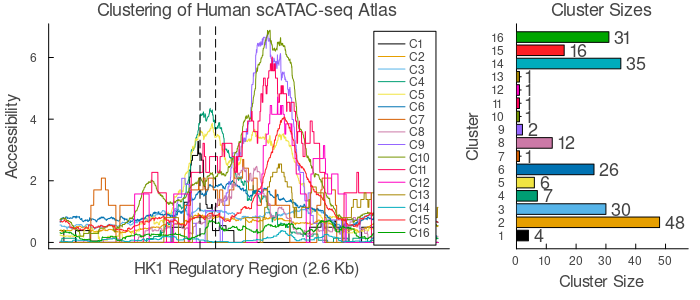

In [15]:
plot_cluster_centres_group(ca_cluster_HK1_raw, xlabel="HK1 Regulatory Region (2.6 Kb)", markregion=regions["hk1_variants"])

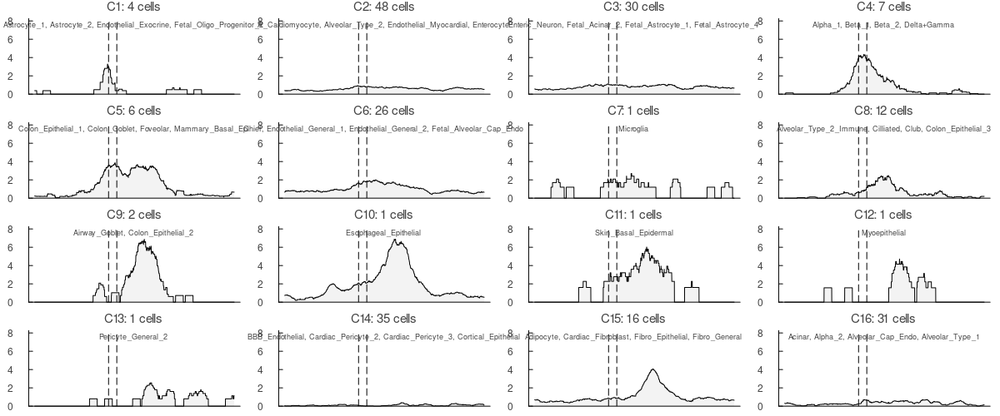

In [16]:
plot_cluster_centres_grid(ca_cluster_HK1_raw, meta, markregion=regions["hk1_variants"])

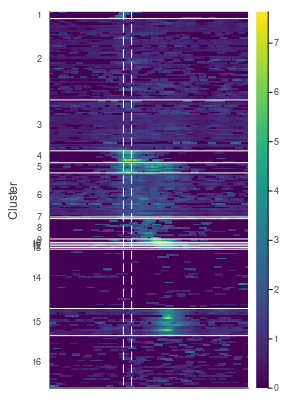

In [17]:
cluster_heatmap(ca_cluster_HK1_raw, markregion=regions["hk1_variants"], size=(300, 400), xticks=false)

In [18]:
clustertable(ca_cluster_HK1_raw, meta)

Row,Cell,Cluster
,String,Int64
1,A_Cardiomyocyte,2
2,Acinar,16
3,Adipocyte,15
4,Airway_Goblet,9
5,Alpha_1,4
6,Alpha_2,16
7,Alveolar_Cap_Endo,16
8,Alveolar_Type_1,16
9,Alveolar_Type_2,2


In [19]:
clustersummary(ca_cluster_HK1_raw, meta)

Row,Cluster,count,Cell
,Int64,Int64,String
1,1,4,"Astrocyte_1, Astrocyte_2, Endothelial_Exocrine, Fetal_Oligo_Progenitor_2"
2,2,48,"A_Cardiomyocyte, Alveolar_Type_2, Endothelial_Myocardial, Enterocyte, Fetal_A_Cardiomyocyte, Fetal_Adrenal_Cortical, Fetal_Adrenal_Neuron, Fetal_Alveolar_Epithelial_1, Fetal_Astrocyte_3, Fetal_B_Lymphocyte_1_SPIB+, Fetal_Chromaffin, Fetal_Enteric_Glia, Fetal_Enterocyte_1, Fetal_Enterocyte_3, Fetal_Erythroblast_2, Fetal_Excitatory_Neuron_1, Fetal_Excitatory_Neuron_2, Fetal_Excitatory_Neuron_3, Fetal_Excitatory_Neuron_4, Fetal_Excitatory_Neuron_9, Fetal_Extravillous_Trophoblast, Fetal_Fibro_Splenic, Fetal_Hepatoblast, Fetal_Inhibitory_Neuron_1, Fetal_Inhibitory_Neuron_2, Fetal_Islet, Fetal_Macrophage_Hepatic_3, Fetal_Mesangial_1, Fetal_Mesangial_2, Fetal_Parietal+Chief, Fetal_Photoreceptor, Fetal_Retinal_Pigment, Fetal_Retinal_Progenitor_2, Fetal_Satellite_1, Fetal_Satellite_2, Fetal_Skeletal_Myocyte_1, Fetal_Sympathoblast, Fetal_Syncitio+Cytotrophoblast, Fetal_T_Lymphocyte_2_Cytotoxic, Fibro_GI, Lymphatic, Mammary_Luminal_Epi_2, Parietal, Sm_Ms_GE_junction, Sm_Ms_Muscularis_2, Sm_Ms_Uterine, T_Lymphocyte_1_CD8+, V_Cardiomyocyte"
3,3,30,"Enteric_Neuron, Fetal_Acinar_2, Fetal_Astrocyte_1, Fetal_Astrocyte_4, Fetal_Cardiac_Fibroblast, Fetal_Ductal, Fetal_Endothelial_General_2, Fetal_Endothelial_General_3, Fetal_Endothelial_Hepatic_2, Fetal_Enterocyte_2, Fetal_Erythroblast_1, Fetal_Erythroblast_3, Fetal_Fibro_GI, Fetal_Fibro_General_1, Fetal_Fibro_General_2, Fetal_Fibro_General_3, Fetal_Fibro_Muscle_1, Fetal_Fibro_Placental_1, Fetal_Gastri_Goblet, Fetal_Macrophage_General_2, Fetal_Macrophage_Hepatic_2, Fetal_Metanephric, Fetal_Retinal_Neuron, Fetal_Retinal_Progenitor_1, Fetal_Schwann_General, Fetal_T_Lymphocyte_4_FASLG+, Fetal_Thymocyte, Fetal_V_Cardiomyocyte, GABA_1, Schwann_General"
4,4,7,"Alpha_1, Beta_1, Beta_2, Delta+Gamma, Gastric_Neuroendocrine, Paneth, Skin_Granular_Epidermal"
5,5,6,"Colon_Epithelial_1, Colon_Goblet, Foveolar, Mammary_Basal_Epi, SI_Goblet, Skin_Eccrine_Epidermal"
6,6,26,"Chief, Endothelial_General_1, Endothelial_General_2, Fetal_Alveolar_Cap_Endo, Fetal_B_Lymphocyte_2_CXCR5+, Fetal_Cilliated, Fetal_Endocardial, Fetal_Endothelial_General_1, Fetal_Endothelial_Hepatic_1, Fetal_Endothelial_Placental, Fetal_Enteric_Neuron, Fetal_Goblet, Fetal_Lymphatic, Fetal_Macrophage_General_1, Fetal_Macrophage_General_3, Fetal_Macrophage_General_4, Fetal_Macrophage_Hepatic_1, Fetal_Macrophage_Placental, Fetal_Pulmonary_Neuroendocrine, Fetal_T_Lymphocyte_1_CD4+, Fetal_T_Lymphocyte_3_IL2+, Fetal_Ureteric_Bud, Follicular, Macrophage_Gen_or_Alv, Macrophage_General, Mammary_Luminal_Epi_1"
7,7,1,Microglia
8,8,12,"Alveolar_Type_2_Immune, Cilliated, Club, Colon_Epithelial_3, Ductal, Endothelial_General_3, Fetal_B_Lymphocyte_3_NPY+, Fetal_Hematopoeitic_Stem, Memory_B, Naive_T, T_lymphocyte_2_CD4+, Tuft"
9,9,2,"Airway_Goblet, Colon_Epithelial_2"


## Cluster Chromatin accessibilty over SCRT1 variant

First cluster on data without max normalisation:

In [20]:
ca_cluster_scrt1_raw = clusterall(regions["scrt1_roi"]..., meta, k=15, ex=0, maxnorm=false, normfun=x -> sqrt.(x));

Progress: 100%|█████████████████████████████████████████| Time: 0:00:00


  0.051747 seconds (136 allocations: 534.625 KiB)


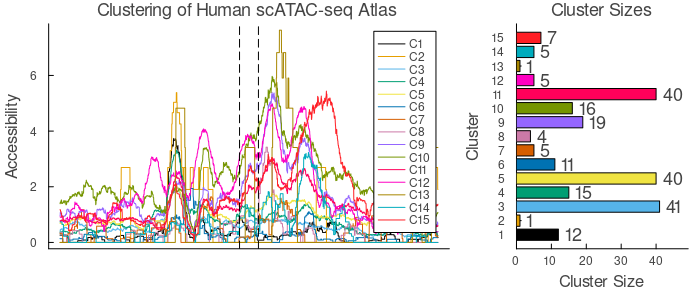

In [21]:
plot_cluster_centres_group(ca_cluster_scrt1_raw, xlabel="", markregion=regions["scrt1_peak"])

Endocrine cells clusterout in cluster 12

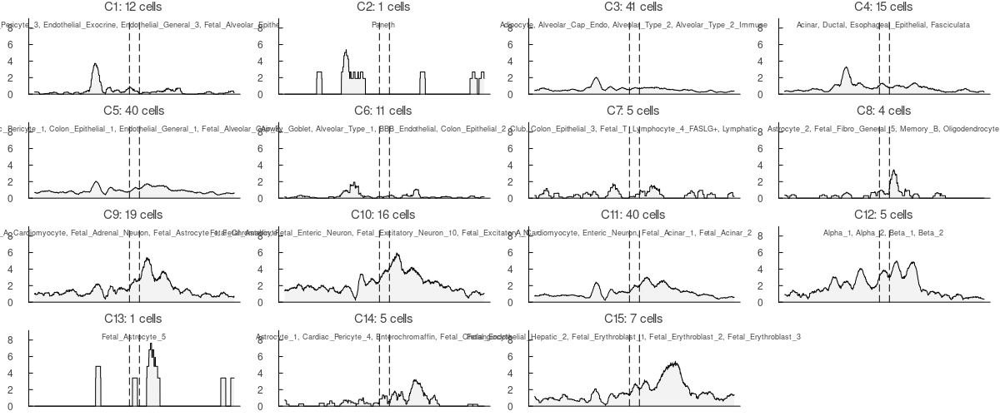

In [22]:
plot_cluster_centres_grid(ca_cluster_scrt1_raw, meta, xlabel="", markregion=regions["scrt1_peak"])

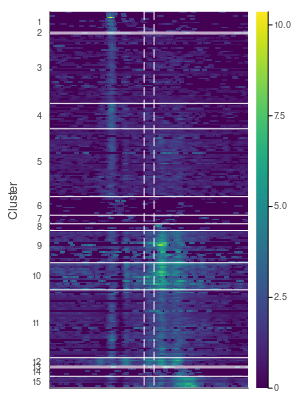

In [23]:
cluster_heatmap(ca_cluster_scrt1_raw, markregion=regions["scrt1_peak"], size=(300, 400), xticks=false)

Plot large version of the with cell identities:

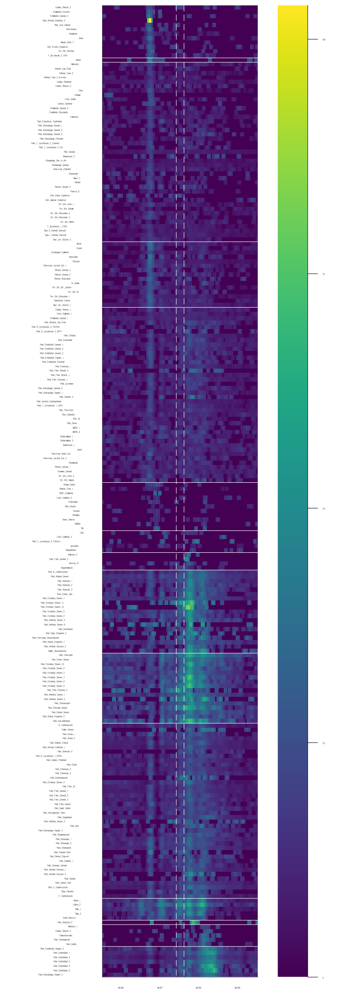

In [24]:
cluster_heatmap(ca_cluster_scrt1_raw, markregion=regions["scrt1_peak"], size=(800, 2200))
plot!(yticks=(1:size(meta, 1), meta.Cell[ca_cluster_scrt1_raw.SI]), yticksfont=font("helvetica", 6), left_margin=30mm)


In [25]:
clustertable(ca_cluster_scrt1_raw, meta)

Row,Cell,Cluster
,String,Int64
1,A_Cardiomyocyte,11
2,Acinar,4
3,Adipocyte,3
4,Airway_Goblet,6
5,Alpha_1,12
6,Alpha_2,12
7,Alveolar_Cap_Endo,3
8,Alveolar_Type_1,6
9,Alveolar_Type_2,3


In [26]:
clustersummary(ca_cluster_scrt1_raw, meta)

Row,Cluster,count,Cell
,Int64,Int64,String
1,1,12,"Cardiac_Pericyte_3, Endothelial_Exocrine, Endothelial_General_3, Fetal_Alveolar_Epithelial_2, Fibro_Liver_Adrenal, Glomerulosa, Hepatocyte, Mast, Natural_Killer_T, Skin_Eccrine_Epidermal, Sm_Ms_Mucosal, T_lymphocyte_2_CD4+"
2,2,1,Paneth
3,3,41,"Adipocyte, Alveolar_Cap_Endo, Alveolar_Type_2, Alveolar_Type_2_Immune, Cardiac_Fibroblast, Cardiac_Pericyte_2, Chief, Cilliated, Colon_Goblet, Cortical_Epithelial, Endothelial_General_2, Endothelial_Myocardial, Enterocyte, Fetal_Extravillous_Trophoblast, Fetal_Macrophage_General_1, Fetal_Macrophage_General_3, Fetal_Macrophage_General_4, Fetal_Macrophage_Placental, Fetal_T_Lymphocyte_2_Cytotoxic, Fetal_T_Lymphocyte_3_IL2+, Fibro_General, Keratinocyte_2, Macrophage_Gen_or_Alv, Macrophage_General, Mammary_Epithelial, Melanocyte, Naive_T, Parietal, Pericyte_General_4, Plasma_B, Skin_Basal_Epidermal, Skin_Granular_Epidermal, Sm_Ms_Colon_1, Sm_Ms_General, Sm_Ms_Muscularis_2, Sm_Ms_Muscularis_3, Sm_Ms_Uterine, T_Lymphocyte_1_CD8+, Type_II_Skeletal_Myocyte, Type_I_Skeletal_Myocyte, Vasc_Sm_Muscle_2"
4,4,15,"Acinar, Ductal, Esophageal_Epithelial, Fasciculata, Follicular, Mammary_Luminal_Epi_1, Pericyte_General_2, Pericyte_General_3, Pericyte_Muscularis, SI_Goblet, Sm_Ms_GE_junction, Sm_Ms_GI, Sm_Ms_Muscularis_1, Transitional_Cortical, Vasc_Sm_Muscle_1"
5,5,40,"Cardiac_Pericyte_1, Colon_Epithelial_1, Endothelial_General_1, Fetal_Alveolar_Cap_Endo, Fetal_B_Lymphocyte_2_CXCR5+, Fetal_B_Lymphocyte_3_NPY+, Fetal_Cilliated, Fetal_Endocardial, Fetal_Endothelial_General_1, Fetal_Endothelial_General_2, Fetal_Endothelial_General_3, Fetal_Endothelial_Hepatic_1, Fetal_Endothelial_Placental, Fetal_Enterocyte_1, Fetal_Fibro_General_4, Fetal_Fibro_Muscle_1, Fetal_Fibro_Placental_1, Fetal_Lymphatic, Fetal_Macrophage_General_2, Fetal_Macrophage_Hepatic_1, Fetal_Satellite_2, Fetal_Syncitio+Cytotrophoblast, Fetal_T_Lymphocyte_1_CD4+, Fetal_Thymocyte, Fibro_Epithelial, Fibro_GI, Fibro_Nerve, GABA_1, GABA_2, Glutamatergic_1, Glutamatergic_2, Keratinocyte_1, Luteal, Mammary_Basal_Epi, Mammary_Luminal_Epi_2, Mesothelial, Pericyte_General_1, Schwann_General, Sm_Ms_Colon_2, Sm_Ms_Vaginal"
6,6,11,"Airway_Goblet, Alveolar_Type_1, BBB_Endothelial, Colon_Epithelial_2, Endocardial, Fibro_Muscle, Foveolar, Microglia, Nerve_Stromal, Satellite, Tuft"
7,7,5,"Club, Colon_Epithelial_3, Fetal_T_Lymphocyte_4_FASLG+, Lymphatic, Myoepithelial"
8,8,4,"Astrocyte_2, Fetal_Fibro_General_5, Memory_B, Oligodendrocyte"
9,9,19,"Fetal_A_Cardiomyocyte, Fetal_Adrenal_Neuron, Fetal_Astrocyte_1, Fetal_Astrocyte_2, Fetal_Astrocyte_3, Fetal_Enteric_Glia, Fetal_Excitatory_Neuron_1, Fetal_Excitatory_Neuron_11, Fetal_Excitatory_Neuron_12, Fetal_Excitatory_Neuron_5, Fetal_Excitatory_Neuron_6, Fetal_Inhibitory_Neuron_2, Fetal_Inhibitory_Neuron_4, Fetal_Mesothelial, Fetal_Oligo_Progenitor_2, Fetal_Pulmonary_Neuroendocrine, Fetal_Retinal_Progenitor_1, Fetal_Skeletal_Myocyte_3, Gastric_Neuroendocrine"


### Cluster SCRT1 data max normed

In [38]:
ca_cluster_scrt1_max = clusterall(regions["scrt1_roi"]..., meta, k=35, ex=0, maxnorm=true, normfun=identity);

Progress: 100%|█████████████████████████████████████████| Time: 0:00:00


  0.049439 seconds (145 allocations: 1.166 MiB)


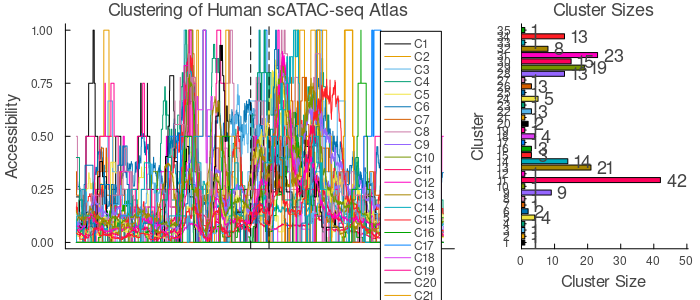

In [39]:
plot_cluster_centres_group(ca_cluster_scrt1_max, xlabel="", markregion=regions["scrt1_peak"])

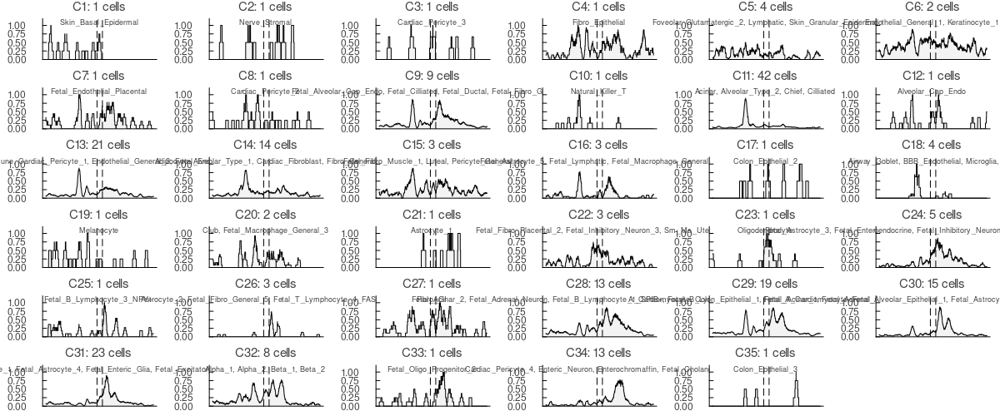

In [40]:
plot_cluster_centres_grid(ca_cluster_scrt1_max, meta, xlabel="", markregion=regions["scrt1_peak"])

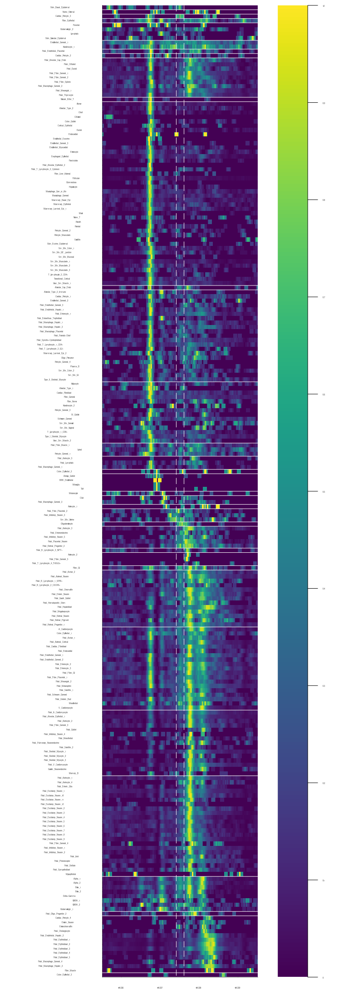

In [41]:
cluster_heatmap(ca_cluster_scrt1_max, markregion=regions["scrt1_peak"], size=(800, 2200))
plot!(yticks=(1:size(meta, 1), meta.Cell[ca_cluster_scrt1_max.SI]), yticksfont=font("helvetica", 6), left_margin=30mm)
